In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
import ast
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime,timedelta
import json
import pickle
import warnings
warnings.filterwarnings('ignore')

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, r2_score
from geopy.distance import geodesic
from tqdm import tqdm
from sklearn.neighbors import BallTree
from math import radians, cos, sin, asin, sqrt
import folium
from folium import plugins
from folium.plugins import HeatMap
import requests, math
from pathlib import Path
import ipywidgets as w
from IPython.display import display, clear_output


In [ ]:
traffic_df = pd.read_csv("/content/drive/MyDrive/DA_Project/BKKBusWaitingTimeEstimation/processed/traffic.csv")
congestion_zones_df = pd.read_csv('/content/drive/MyDrive/DA_Project/BKKBusWaitingTimeEstimation/cleaned/congestion_zones.csv')
stops_df = pd.read_csv('/content/drive/MyDrive/DA_Project/BKKBusWaitingTimeEstimation/cleaned/cleaned_bus_stops_file.csv')
routes_df = pd.read_csv('/content/drive/MyDrive/DA_Project/BKKBusWaitingTimeEstimation/cleaned/cleaned_bus_routes_file.csv')

print(f"Loaded {len(traffic_df):,} traffic records")
print(f"Loaded {len(stops_df)} bus stops")
print(f"Loaded {len(routes_df)} bus routes\n")
print(f"Loaded {len(congestion_zones_df )} congestion zones\n")

Loaded 1,549,600 traffic records
Loaded 4674 bus stops
Loaded 578 bus routes

Loaded 1361 congestion zones



In [ ]:
def get_traffic_near_route(route_coords, traffic_data, buffer=0.003):
    """Extract traffic data within buffer distance of route"""
    route_traffic = []

    for coord in route_coords:
        if isinstance(coord, (list, tuple)) and len(coord) == 2:
            lon, lat = coord
            nearby = traffic_data[
                (abs(traffic_data['lat'] - lat) < buffer) &
                (abs(traffic_data['lon'] - lon) < buffer)
            ].copy()

            if not nearby.empty:
                nearby['route_lat'] = lat
                nearby['route_lon'] = lon
                route_traffic.append(nearby)

    if route_traffic:
        return pd.concat(route_traffic, ignore_index=True)
    return pd.DataFrame()

# Analyze traffic for each bus route
route_traffic_dict = {}

print("Analyzing traffic patterns for each route...")
for idx, route in routes_df.iterrows():
    # route_id = route['ref'] if pd.notna(route['ref']) else str(route['route_id'])
    route_id = str(route['route_id'])

    # Manually parse the string representation of the list of coordinates
    try:
        # Remove brackets and split by comma, then convert to float pairs
        coords_str = route['coordinates'].strip('[]')
        coords = []
        for pair_str in coords_str.split('], ['):
            lon_str, lat_str = pair_str.strip('[]').split(',')
            coords.append([float(lon_str), float(lat_str)])

        if not isinstance(coords, list):
             coords = [] # Should not happen with manual parsing, but safety
    except Exception as e:
        print(f"Error parsing coordinates for route {route_id}: {e}")
        coords = [] # Handle any parsing errors


    route_traffic = get_traffic_near_route(coords, traffic_df)

    if not route_traffic.empty and len(route_traffic) > 1000:
        route_traffic_dict[route_id] = route_traffic
        print(f"   Route {route_id}: {len(route_traffic):,} traffic points")

Analyzing traffic patterns for each route...
   Route 1700755: 2,481 traffic points
   Route 1701250: 2,481 traffic points
   Route 1701251: 19,763 traffic points
   Route 2148296: 13,254 traffic points
   Route 2170840: 34,502 traffic points
   Route 2172576: 43,602 traffic points
   Route 2172595: 59,420 traffic points
   Route 2174648: 55,420 traffic points
   Route 2341849: 12,979 traffic points
   Route 2341850: 38,620 traffic points
   Route 2341851: 28,715 traffic points
   Route 2446915: 69,804 traffic points
   Route 2447814: 95,033 traffic points
   Route 2465747: 48,320 traffic points
   Route 2466740: 16,298 traffic points
   Route 2474122: 37,942 traffic points
   Route 2793245: 2,377 traffic points
   Route 3088576: 22,509 traffic points
   Route 3088610: 9,799 traffic points
   Route 3999294: 31,064 traffic points
   Route 3999295: 26,381 traffic points
   Route 3999302: 23,842 traffic points
   Route 3999303: 24,246 traffic points
   Route 7410374: 52,058 traffic points

DATA VISUALISATION

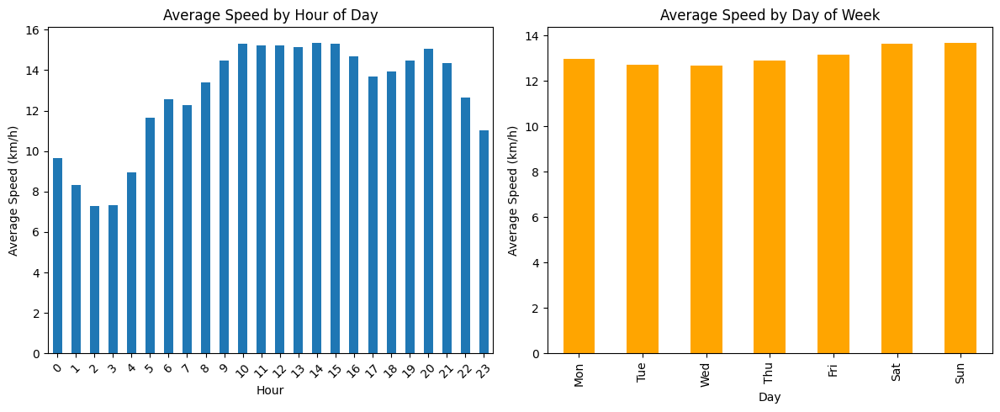

In [ ]:
plt.figure(figsize=(12,5))

plt.subplot(1,2,1)
hourly_speed = traffic_df.groupby('hour')['speed'].mean()
hourly_speed.plot(kind='bar')
plt.title('Average Speed by Hour of Day')
plt.xlabel('Hour')
plt.ylabel('Average Speed (km/h)')
plt.xticks(rotation=45)

plt.subplot(1,2,2)
daily_speed = traffic_df.groupby('day_of_week')['speed'].mean()
days = ['Mon','Tue','Wed','Thu','Fri','Sat','Sun']
daily_speed.index = days
daily_speed.plot(kind='bar', color='orange')
plt.title('Average Speed by Day of Week')
plt.xlabel('Day')
plt.ylabel('Average Speed (km/h)')

plt.tight_layout()
plt.show()

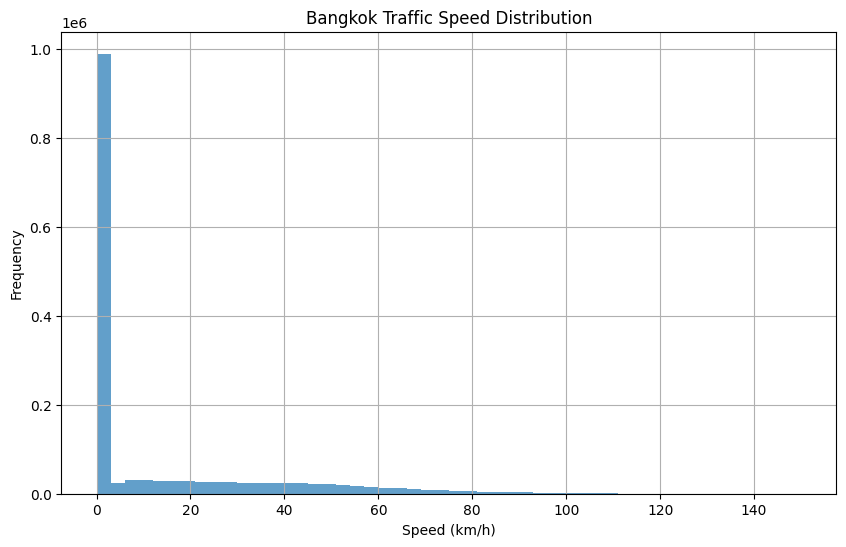

In [ ]:
plt.figure(figsize=(10,6))
traffic_df['speed'].hist(bins=50, alpha=0.7)
plt.title('Bangkok Traffic Speed Distribution')
plt.xlabel('Speed (km/h)')
plt.ylabel('Frequency')
plt.show()


In [ ]:
congested_traffic = traffic_df[traffic_df['speed'] < 15].copy()

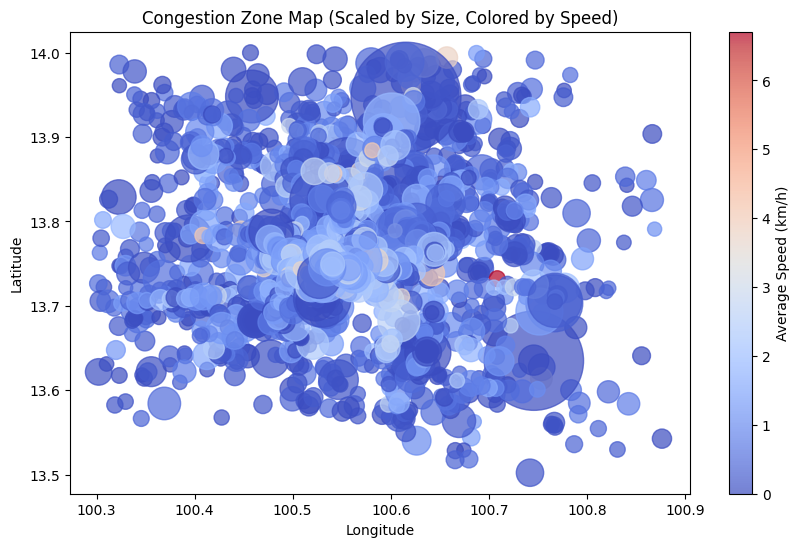

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(
    congestion_zones_df['center_lon'],
    congestion_zones_df['center_lat'],
    s=congestion_zones_df['size'] * 2,
    c=congestion_zones_df['avg_speed'],
    cmap='coolwarm',
    alpha=0.7
)

plt.colorbar(label='Average Speed (km/h)')
plt.title('Congestion Zone Map (Scaled by Size, Colored by Speed)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


In [ ]:
m = folium.Map(
    location=[congested_traffic['lat'].mean(), congested_traffic['lon'].mean()],
    zoom_start=12,
    tiles='cartodbpositron'
)


heat_data = list(zip(
    congested_traffic['lat'],
    congested_traffic['lon'],
    1 / (congested_traffic['speed'] + 0.1)
))

HeatMap(
    heat_data,
    radius=10,
    blur=15,
    min_opacity=0.4,
    max_zoom=13
).add_to(m)


for _, row in congestion_zones_df.iterrows():
    color = 'red' if row['severity'] == 'Critical' else 'orange'

    folium.CircleMarker(
        location=[row['center_lat'], row['center_lon']],
        radius=max(5, row['size'] / 40),  # scale by cluster size
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=(
            f"<b>Zone ID:</b> {row['zone_id']}<br>"
            f"<b>Avg Speed:</b> {row['avg_speed']:.2f} km/h<br>"
            f"<b>Severity:</b> {row['severity']}<br>"
            f"<b>Points:</b> {row['size']}"
        )
    ).add_to(m)


legend_html = '''
<div style="position: fixed; bottom: 50px; left: 50px; width: 160px;
            background-color: white; border:2px solid grey; z-index:9999;
            font-size:14px; padding:10px;">
<b>Severity Legend</b><br>
<i style="background:red; width:10px; height:10px; display:inline-block;"></i> Critical<br>
<i style="background:orange; width:10px; height:10px; display:inline-block;"></i> High<br>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))


m.save("congestion_zones_combined.html")
m


In [ ]:
with open('/content/drive/MyDrive/DA_Project/BKKBusWaitingTimeEstimation/model3/route_models.pkl', 'rb') as f:
    route_models = pickle.load(f)
with open('/content/drive/MyDrive/DA_Project/BKKBusWaitingTimeEstimation/model3/feature_columns.pkl', 'rb') as f:
    feature_columns = pickle.load(f)


In [ ]:
# Normalize keys
routes_df['route_id'] = routes_df['route_id'].astype(str).str.strip()
route_models = {str(k).strip(): v for k, v in route_models.items()}


In [ ]:
routes_df['segment_distance_list'] = routes_df['segment_distance_list'].apply(
    lambda x: ast.literal_eval(x) if isinstance(x, str) else x
)
routes_df['coordinates'] = routes_df['coordinates'].apply(
    lambda x: ast.literal_eval(x) if isinstance(x, str) else x
)

In [ ]:
# === Define real-time feature builder ===
try:
    from zoneinfo import ZoneInfo
    tz = ZoneInfo("Asia/Bangkok")
except Exception:
    tz = None

def current_bkk_time():
    if tz is not None:
        return datetime.now(tz)
    return datetime.now()

In [ ]:
def make_features(lat, lon, t=None,heading=0):
    """Generate feature row matching model's features"""
    if t is None:
        t = current_bkk_time()
    hour = t.hour
    day_of_week = t.weekday()
    is_weekend = 1 if day_of_week >= 5 else 0
    is_rush_hour = 1 if (7 <= hour <= 9) or (16 <= hour <= 19) else 0

    # Bangkok center
    bangkok_center_lat, bangkok_center_lon = 13.7563, 100.5018
    distance_from_center = sqrt(
        (lat - bangkok_center_lat)**2 +
        (lon - bangkok_center_lon)**2
    )

    # Grid cells (assuming 0.01 degree grid)
    lat_grid = round(lat * 100) / 100
    lon_grid = round(lon * 100) / 100

    return {
        'lat': lat,
        'lon': lon,
        'heading': heading,
        'hour': hour,
        'day_of_week': day_of_week,
        'is_weekend': is_weekend,
        'is_rush_hour': is_rush_hour,
        'lat_grid': lat_grid,
        'lon_grid': lon_grid,
        'distance_from_center': distance_from_center,
        'near_congestion': 0,  # Will be updated if needed
        'congestion_severity_encode': 0,
        'distance_to_congestion': 9999,
        'congestion_avg_speed': 0
    }


In [ ]:
# === Predict travel times ===
route_summaries = []
segment_details = []

for route_id, model_info in route_models.items():
    if route_id not in routes_df['route_id'].values:
        print(f"Skipping {route_id} — not found in Excel.")
        continue

    model = model_info['model']
    if route_id in feature_columns:
        cols_used = feature_columns[route_id]
    else:
        cols_used = model_info.get('features_used', [])
    if not cols_used:
        print(f" No feature list for {route_id}, skipping.")
        continue

    route_row = routes_df[routes_df['route_id'] == route_id].iloc[0]
    coords = route_row['coordinates']
    segs = route_row['segment_distance_list']

    if not coords or not segs:
        continue

    n_segments = min(len(coords) - 1, len(segs))
    X_pred = pd.DataFrame([make_features(coords[i][0], coords[i][1]) for i in range(n_segments)])
    X_pred = X_pred.reindex(columns=cols_used, fill_value=0)

    try:
        predicted_speeds = model.predict(X_pred)
    except Exception as e:
        print(f"Model failed for {route_id}: {e}")
        continue

    times_min = []
    cumulative_min = 0

    for i in range(n_segments):
        dist_km = float(segs[i])
        speed = max(predicted_speeds[i], 1)
        time_min = (dist_km / speed) * 60
        cumulative_min += time_min
        times_min.append(time_min)

        segment_details.append({
            'route_id': route_id,
            'segment_index': i + 1,
            'start_lat': coords[i][0],
            'start_lon': coords[i][1],
            'end_lat': coords[i+1][0],
            'end_lon': coords[i+1][1],
            'distance_km': dist_km,
            'predicted_speed_kmh': speed,
            'segment_travel_time_min': time_min,
            'cumulative_travel_time_min': cumulative_min
        })

    total_time_min = np.sum(times_min)
    avg_speed = np.mean(predicted_speeds)

    route_summaries.append({
        'route_id': route_id,
        'name': route_row['name'],
        'num_stops': route_row['num_stops'],
        'total_distance_km': route_row['total_distance_km'],
        'avg_predicted_speed_kmh': avg_speed,
        'total_predicted_travel_time_min': total_time_min
    })

In [ ]:
summary_df = pd.DataFrame(route_summaries)
segments_df = pd.DataFrame(segment_details)

In [ ]:
start_lat_col = 'start_lat'
start_lon_col = 'start_lon'
end_lat_col = 'end_lat'
end_lon_col = 'end_lon'

stop_lon_col = 'lat'
stop_lat_col = 'lon'
stop_name_col = 'refname'
# Fix reversed coordinates
stops_df['fixed_lat'] = stops_df[stop_lat_col]
stops_df['fixed_lon'] = stops_df[stop_lon_col]
# --- Clean up any missing or invalid coordinates ---
stops_df = stops_df.dropna(subset=['fixed_lat', 'fixed_lon'])
stops_df = stops_df[(stops_df['fixed_lat'] != 0) & (stops_df['fixed_lon'] != 0)]
# Make sure they're numeric
stops_df['fixed_lat'] = pd.to_numeric(stops_df['fixed_lat'], errors='coerce')
stops_df['fixed_lon'] = pd.to_numeric(stops_df['fixed_lon'], errors='coerce')
stops_df = stops_df.dropna(subset=['fixed_lat', 'fixed_lon'])

In [ ]:
# Build KDTree (fast lookup)
stops_coords = np.radians(stops_df[['fixed_lat', 'fixed_lon']])
tree = BallTree(stops_coords, metric='haversine')

def map_nearest_stop(lat_series, lon_series, stops_df, tree):
    coords = np.radians(np.vstack((lat_series, lon_series)).T)
    distances, indices = tree.query(coords, k=1)
    distances_m = distances.flatten() * 6371000  # convert radians to meters
    names = stops_df.iloc[indices.flatten()]['refname'].values
    return names, distances_m




In [ ]:
# Map start and end coordinates
segments_df['start_stop'], segments_df['start_distance_m'] = map_nearest_stop(
    segments_df[start_lat_col], segments_df[start_lon_col], stops_df, tree)

segments_df['end_stop'], segments_df['end_distance_m'] = map_nearest_stop(
    segments_df[end_lat_col], segments_df[end_lon_col], stops_df, tree)

In [ ]:
required_cols = ['route_id', 'segment_index', 'start_stop', 'start_lat', 'start_lon', 'end_stop', 'end_lat', 'end_lon', 'distance_km', 'predicted_speed_kmh', 'segment_travel_time_min']

output_df = segments_df[required_cols]

VISUALIZATION

In [ ]:
STOP_LAT  = "lat"
STOP_LON  = "lon"
STOP_NAME = "refname"

# parse routes.coordinates safely and drop bad rows
def to_valid_latlon_list(x):
    try:
        pts = ast.literal_eval(x) if isinstance(x, str) else x
    except Exception:
        return []
    out = []
    if isinstance(pts, (list, tuple)):
        for p in pts:
            if isinstance(p, (list, tuple)) and len(p) >= 2:
                lon, lat = p[0], p[1]
                if pd.notna(lat) and pd.notna(lon):
                    out.append([float(lat), float(lon)])  # folium wants [lat, lon]
    return out

routes_ok = routes_df.copy()
routes_ok =  routes_ok[routes_ok['route_id'].isin(route_models.keys())]
routes_ok["latlon"] = routes_ok["coordinates"].apply(to_valid_latlon_list)
routes_ok = routes_ok[routes_ok["latlon"].apply(lambda L: len(L) >= 2)].reset_index(drop=True)

stops_ok = stops_df.dropna(subset=[STOP_LAT, STOP_LON]).copy()

print("routes_ok:", routes_ok.shape, "| stops_ok:", stops_ok.shape)

routes_ok: (578, 9) | stops_ok: (4665, 6)


In [ ]:
ROUTE_ID  = "route_id"
STOP_LAT  = "lat"
STOP_LON  = "lon"
STOP_NAME = "refname"
STOP_MATCH_RADIUS_M = 200  # bump to 300 if you see too few dots

def haversine_m(lat1, lon1, lat2, lon2):
    R = 6371000.0
    phi1 = np.radians(lat1); phi2 = np.radians(lat2)
    dphi = np.radians(lat2 - lat1); dl = np.radians(lon2 - lon1)
    a = np.sin(dphi/2)**2 + np.cos(phi1)*np.cos(phi2)*np.sin(dl/2)**2
    return 2*R*np.arcsin(np.sqrt(a))

def stops_for_route(route_id, coords_latlon, stops_df, threshold_m=STOP_MATCH_RADIUS_M, sample_step=5):
    # 1) exact mapping if your stops file has route_id
    if "route_id" in stops_df.columns:
        sub = stops_df[stops_df["route_id"] == route_id]
        if len(sub):
            return sub

    # 2) fallback: near the route polyline
    if not coords_latlon or len(stops_df) == 0:
        return stops_df.iloc[0:0].copy()

    sampled = coords_latlon[::max(1, sample_step)]  # thin to speed up
    poly_lat = np.array([p[0] for p in sampled]); poly_lon = np.array([p[1] for p in sampled])

    s = stops_df.dropna(subset=[STOP_LAT, STOP_LON]).copy()
    slat = s[STOP_LAT].to_numpy(dtype=float); slon = s[STOP_LON].to_numpy(dtype=float)

    min_d = np.full(len(s), np.inf)
    for i in range(len(sampled)):
        d = haversine_m(slat, slon, poly_lat[i], poly_lon[i])
        min_d = np.minimum(min_d, d)

    return s[min_d <= threshold_m].copy()

In [ ]:
def make_label(row):
    txt = f"{row.get('name','')}".strip()
    return txt or str(row[ROUTE_ID])

In [ ]:
def show_route_with_stops_raw(route_id):
    row = routes_ok.loc[routes_ok[ROUTE_ID] == route_id]
    if row.empty:
        raise ValueError(f"Route {route_id} not in routes_ok.")
    coords = row.iloc[0]["latlon"]

    subset = stops_for_route(route_id, coords, stops_ok)

    lats = [p[0] for p in coords]; lons = [p[1] for p in coords]
    m = folium.Map(location=[float(np.mean(lats)), float(np.mean(lons))],
                   zoom_start=13, control_scale=True)
    folium.PolyLine(coords, weight=5, opacity=0.7,
                    tooltip=f"Route {route_id} (raw)").add_to(m)
    m.fit_bounds([[min(lats), min(lons)], [max(lats), max(lons)]])

    # red dots = only this route’s stops
    for _, s in subset.iterrows():
        folium.CircleMarker(
            [float(s[STOP_LAT]), float(s[STOP_LON])],
            radius=5, color="red", fill=True, fill_opacity=0.95,
            tooltip=str(s.get(STOP_NAME,""))
        ).add_to(m)

    print(f"Stops plotted: {len(subset)}  |  (radius={STOP_MATCH_RADIUS_M} m)")
    return m


In [ ]:

def display_segment_table(route_id):
    # Check if route exists in the models
    if route_id not in route_models:
        # print(f"NO MODEL AVAILABLE FOR ROUTE {route_id}!")
        return

    # Check if route exists in routes_df
    if route_id not in routes_df['route_id'].values:
        print(f"Route {route_id} not found in routes data!")
        return

    model_info = route_models[route_id]
    model = model_info['model']

    # Get features used by the model
    if 'feature_columns' in globals() and route_id in feature_columns:
        cols_used = feature_columns[route_id]
    else:
        cols_used = model_info.get('features_used', [])

    # Get route data
    route_row = routes_df[routes_df['route_id'] == route_id].iloc[0]
    coords = route_row['coordinates']
    segs = route_row['segment_distance_list']

    if not coords or not segs:
        print("No coordinate or segment data available!")
        return

    # Prepare predictions
    n_segments = min(len(coords) - 1, len(segs))
    X_pred = pd.DataFrame([make_features(coords[i][0], coords[i][1]) for i in range(n_segments)])
    X_pred = X_pred.reindex(columns=cols_used, fill_value=0)

    try:
        predicted_speeds = model.predict(X_pred)
    except Exception as e:
        print(f"Model prediction failed for {route_id}: {e}")
        return

    # Build segment details
    segment_list = []
    cumulative_min = 0

    for i in range(n_segments):
        dist_km = float(segs[i])
        speed = max(predicted_speeds[i], 1)
        time_min = (dist_km / speed) * 60
        cumulative_min += time_min

        segment_list.append({
            'segment_index': i + 1,
            'start_lat': coords[i][0],
            'start_lon': coords[i][1],
            'end_lat': coords[i+1][0],
            'end_lon': coords[i+1][1],
            'distance_km': dist_km,
            'predicted_speed_kmh': speed,
            'segment_travel_time_min': time_min,
            'cumulative_travel_time_min': cumulative_min
        })

    # Create DataFrame
    segs_df = pd.DataFrame(segment_list)

    # Map nearest stops
    segs_df['start_stop'], segs_df['start_distance_m'] = map_nearest_stop(
        segs_df['start_lat'], segs_df['start_lon'], stops_df, tree)

    segs_df['end_stop'], segs_df['end_distance_m'] = map_nearest_stop(
        segs_df['end_lat'], segs_df['end_lon'], stops_df, tree)

    # Calculate Time/km
    segs_df['Time/km (min)'] = segs_df['segment_travel_time_min'] / segs_df['distance_km']

    # Create total row
    total = pd.DataFrame({
        'segment_index': ['TOTAL'],
        'start_stop': ['—'],
        'end_stop': ['—'],
        'distance_km': [segs_df['distance_km'].sum()],
        'predicted_speed_kmh': [segs_df['predicted_speed_kmh'].mean()],
        'segment_travel_time_min': [segs_df['segment_travel_time_min'].sum()],
        'cumulative_travel_time_min': [segs_df['cumulative_travel_time_min'].max()],
        'Time/km (min)': [segs_df['segment_travel_time_min'].sum() / segs_df['distance_km'].sum()]
    })

    # Combine data and total
    segs_display = pd.concat([
        segs_df[['segment_index', 'start_stop', 'end_stop', 'distance_km',
                 'predicted_speed_kmh', 'segment_travel_time_min',
                 'cumulative_travel_time_min', 'Time/km (min)']],
        total
    ], ignore_index=True)

    # Apply conditional formatting for speed
    def color_speed(val):
        if isinstance(val, str):
            return ''
        if val < 15:
            return 'background-color: #ffebee; color: #c62828'
        elif val < 25:
            return 'background-color: #fff3e0; color: #e65100'
        elif val < 40:
            return 'background-color: #fffde7; color: #f57f17'
        else:
            return 'background-color: #e8f5e9; color: #2e7d32'

    # Style and display
    styled = (segs_display.style
              .format({
                  'distance_km': '{:.3f}',
                  'predicted_speed_kmh': '{:.2f}',
                  'segment_travel_time_min': '{:.2f}',
                  'cumulative_travel_time_min': '{:.2f}',
                  'Time/km (min)': '{:.2f}'
              }, na_rep='—')
              .applymap(color_speed, subset=['predicted_speed_kmh'])
              .set_caption(f"Segment-by-Segment Details - Route {route_id}")
              .set_table_styles([
                  {'selector': 'caption',
                   'props': [('caption-side', 'top'),
                            ('font-size', '16px'),
                            ('font-weight', 'bold'),
                            ('color', '#333'),
                            ('margin-bottom', '12px')]},
                  {'selector': 'thead th',
                   'props': [('background-color', '#1976d2'),
                            ('color', 'white'),
                            ('font-weight', 'bold'),
                            ('padding', '12px'),
                            ('text-align', 'center'),
                            ('border', '1px solid #ddd'),
                            ('font-size', '13px')]},
                  {'selector': 'tbody td',
                   'props': [('padding', '10px'),
                            ('text-align', 'center'),
                            ('border', '1px solid #ddd'),
                            ('font-size', '13px')]},
                  {'selector': 'tbody tr:nth-child(even)',
                   'props': [('background-color', '#f5f5f5')]},
                  {'selector': 'tbody tr:last-child',
                   'props': [('background-color', '#e3f2fd'),
                            ('font-weight', 'bold'),
                            ('border-top', '2px solid #1976d2')]},
                  {'selector': 'tbody tr:hover:not(:last-child)',
                   'props': [('background-color', '#bbdefb')]},
                  {'selector': 'table',
                   'props': [('border-collapse', 'collapse'),
                            ('width', '100%'),
                            ('border', '1px solid #ddd')]}
              ]))

    display(styled)

    # Separator
    display(HTML("<hr style='border: none; border-top: 2px solid #ddd; margin: 30px 0;'>"))

    # Layout: Summary cards (vertical stack) beside cumulative chart
    summary_html = f"""
    <div style="display: grid; grid-template-columns: repeat(3, 1fr); gap: 15px; margin-top: 20px;">
        <div style="background: linear-gradient(135deg, #667eea 0%, #764ba2 100%); color: white; padding: 15px; border-radius: 8px; text-align: center;">
            <div style="font-size: 14px; opacity: 0.9;">Total Distance</div>
            <div style="font-size: 28px; font-weight: bold; margin: 5px 0;">{segs_df['distance_km'].sum():.2f}</div>
            <div style="font-size: 12px; opacity: 0.8;">kilometers</div>
        </div>
        <div style="background: linear-gradient(135deg, #f093fb 0%, #f5576c 100%); color: white; padding: 15px; border-radius: 8px; text-align: center;">
            <div style="font-size: 14px; opacity: 0.9;">Total Travel Time</div>
            <div style="font-size: 28px; font-weight: bold; margin: 5px 0;">{segs_df['segment_travel_time_min'].sum():.1f}</div>
            <div style="font-size: 12px; opacity: 0.8;">minutes ({segs_df['segment_travel_time_min'].sum()/60:.1f} hours)</div>
        </div>
        <div style="background: linear-gradient(135deg, #4facfe 0%, #00f2fe 100%); color: white; padding: 15px; border-radius: 8px; text-align: center;">
            <div style="font-size: 14px; opacity: 0.9;">Average Speed</div>
            <div style="font-size: 28px; font-weight: bold; margin: 5px 0;">{segs_df['predicted_speed_kmh'].mean():.1f}</div>
            <div style="font-size: 12px; opacity: 0.8;">km/h</div>
        </div>
    </div>

    """
    display(HTML(summary_html))
    # Separator
    display(HTML("<hr style='border: none; border-top: 2px solid #ddd; margin: 30px 0;'>"))

    # Cumulative travel time chart
    fig, ax = plt.subplots(figsize=(12, 6))
    segments = segs_df['segment_index'].values
    ax.plot(segments, segs_df['cumulative_travel_time_min'].values, marker='o', linewidth=2.5,
            color='#1976d2', markersize=7, markerfacecolor='#64b5f6', markeredgecolor='#1976d2', markeredgewidth=2)
    ax.fill_between(segments, segs_df['cumulative_travel_time_min'].values, alpha=0.2, color='#1976d2')
    ax.set_xlabel('Segment Number', fontweight='bold', fontsize=12)
    ax.set_ylabel('Cumulative Time (minutes)', fontweight='bold', fontsize=12)
    ax.set_title('Cumulative Travel Time Across Route', fontweight='bold', fontsize=14, pad=15)
    ax.grid(True, alpha=0.3, linestyle='--')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    plt.tight_layout()
    plt.show()


In [ ]:
# --- Function: Route Chart ---
def display_route_chart(route_id):
    if str(route_id) not in route_traffic_dict:
        print(f"No traffic data available for route {route_id}")
        return

    main_route_traffic = route_traffic_dict[str(route_id)]
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))

    # 1️⃣ Speed by Hour
    hourly_speed = main_route_traffic.groupby('hour')['speed'].agg(['mean', 'std'])
    axes[0, 0].plot(hourly_speed.index, hourly_speed['mean'], marker='o', linewidth=2.5, color='steelblue')
    axes[0, 0].fill_between(hourly_speed.index,
                            hourly_speed['mean'] - hourly_speed['std'],
                            hourly_speed['mean'] + hourly_speed['std'],
                            alpha=0.3, color='steelblue')
    axes[0, 0].axhline(y=20, color='red', linestyle='--', linewidth=2, label='Congestion Threshold (20 km/h)')
    axes[0, 0].set_xlabel('Hour of Day')
    axes[0, 0].set_ylabel('Average Speed (km/h)')
    axes[0, 0].set_title(f'Traffic Speed Pattern - Route {route_id}', fontweight='bold')
    axes[0, 0].legend()
    axes[0, 0].grid(True, alpha=0.3)
    axes[0, 0].set_xticks(range(0, 24, 2))

    # 2️⃣ Speed Distribution
    axes[0, 1].hist(main_route_traffic['speed'], bins=60, edgecolor='black', alpha=0.7, color='skyblue')
    mean_speed = main_route_traffic['speed'].mean()
    axes[0, 1].axvline(x=mean_speed, color='red', linestyle='--', linewidth=2, label=f'Mean: {mean_speed:.1f} km/h')
    axes[0, 1].set_xlabel('Speed (km/h)')
    axes[0, 1].set_ylabel('Frequency')
    axes[0, 1].set_title('Traffic Speed Distribution', fontweight='bold')
    axes[0, 1].legend()
    axes[0, 1].grid(True, alpha=0.3, axis='y')

    # 3️⃣ Rush Hour vs Normal Hours
    rush_comparison = main_route_traffic.groupby('is_rush_hour')['speed'].mean()
    bars = axes[1, 0].bar(['Normal Hours', 'Rush Hours'], rush_comparison.values,
                          color=['green', 'red'], alpha=0.7, edgecolor='black', linewidth=2)
    axes[1, 0].set_ylabel('Average Speed (km/h)')
    axes[1, 0].set_title('Rush Hour vs Normal Hours', fontweight='bold')
    axes[1, 0].grid(True, alpha=0.3, axis='y')
    for bar in bars:
        height = bar.get_height()
        axes[1, 0].text(bar.get_x() + bar.get_width()/2., height, f'{height:.1f}',
                        ha='center', va='bottom', fontweight='bold')

    # 4️⃣ Day of Week
    daily_speed = main_route_traffic.groupby('day_of_week')['speed'].mean().reindex(range(7))
    days = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']
    bars2 = axes[1, 1].bar(days, daily_speed.fillna(0).values, color='coral', edgecolor='black', alpha=0.7, linewidth=1.5)
    axes[1, 1].set_ylabel('Average Speed (km/h)')
    axes[1, 1].set_title('Average Speed by Day of Week', fontweight='bold')
    axes[1, 1].grid(True, alpha=0.3, axis='y')
    for bar in bars2:
        height = bar.get_height()
        axes[1, 1].text(bar.get_x() + bar.get_width()/2., height, f'{height:.0f}',
                        ha='center', va='bottom', fontsize=9)

    plt.tight_layout()
    plt.show()

# --- Function: Route Map ---
def show_route_with_stops_raw(route_id):
    row = routes_ok.loc[routes_ok[ROUTE_ID] == route_id]
    if row.empty:
        print(f"Route {route_id} not found in routes data")
        return None

    coords = row.iloc[0]["latlon"]
    subset = stops_for_route(route_id, coords, stops_ok)
    lats = [p[0] for p in coords]
    lons = [p[1] for p in coords]

    m = folium.Map(location=[float(np.mean(lats)), float(np.mean(lons))],
                   zoom_start=13, control_scale=True)
    folium.PolyLine(coords, weight=5, opacity=0.7, tooltip=f"Route {route_id}").add_to(m)
    for _, s in subset.iterrows():
        folium.CircleMarker(
            [float(s[STOP_LAT]), float(s[STOP_LON])],
            radius=5, color="red", fill=True, fill_opacity=0.95,
            tooltip=str(s.get(STOP_NAME, ""))
        ).add_to(m)

    print(f"Stops plotted: {len(subset)}")
    return m

# --- Function: Display Model Performance ---
def display_model_performance(route_id):
    if route_id not in route_models:
        print(f"No model data available for route {route_id}")
        return

    model_info = route_models[route_id]
    mae = model_info.get('mae', 'N/A')
    r2 = model_info.get('r2', 'N/A')
    data_points = model_info.get('data_points', 'N/A')
    features_used = model_info.get('features_used', [])

    # Create performance metrics HTML
    html_content = f"""
    <div style="background-color: #f8f9fa; padding: 20px; border-radius: 10px; border-left: 5px solid #4a90e2;">
        <h4 style="color: #2a5599; margin-top: 0;">🤖 Model Performance Metrics</h4>
        <div style="display: grid; grid-template-columns: repeat(auto-fit, minmax(200px, 1fr)); gap: 15px; margin-top: 15px;">
            <div style="background: white; padding: 15px; border-radius: 8px; box-shadow: 0 2px 4px rgba(0,0,0,0.1);">
                <div style="color: #666; font-size: 12px; text-transform: uppercase; margin-bottom: 5px;">Mean Absolute Error</div>
                <div style="color: #2a5599; font-size: 24px; font-weight: bold;">{mae:.3f}</div>
                <div style="color: #888; font-size: 11px; margin-top: 3px;">km/h</div>
            </div>
            <div style="background: white; padding: 15px; border-radius: 8px; box-shadow: 0 2px 4px rgba(0,0,0,0.1);">
                <div style="color: #666; font-size: 12px; text-transform: uppercase; margin-bottom: 5px;">R² Score</div>
                <div style="color: #2a5599; font-size: 24px; font-weight: bold;">{r2:.4f}</div>
                <div style="color: #888; font-size: 11px; margin-top: 3px;">Variance explained</div>
            </div>
            <div style="background: white; padding: 15px; border-radius: 8px; box-shadow: 0 2px 4px rgba(0,0,0,0.1);">
                <div style="color: #666; font-size: 12px; text-transform: uppercase; margin-bottom: 5px;">Training Data Points</div>
                <div style="color: #2a5599; font-size: 24px; font-weight: bold;">{data_points:,}</div>
                <div style="color: #888; font-size: 11px; margin-top: 3px;">Traffic records</div>
            </div>
        </div>
        <div style="background: white; padding: 15px; border-radius: 8px; box-shadow: 0 2px 4px rgba(0,0,0,0.1); margin-top: 15px;">
            <div style="color: #666; font-size: 12px; text-transform: uppercase; margin-bottom: 8px;">Features Used</div>
            <div style="color: #333; font-size: 14px;">
                {', '.join([f'<span style="background: #e3f2fd; padding: 3px 8px; border-radius: 4px; margin-right: 5px; display: inline-block; margin-bottom: 5px;">{feat}</span>' for feat in features_used])}
            </div>
        </div>
        <div style="margin-top: 15px; padding: 10px; background: #e8f4f8; border-radius: 5px;">
            <div style="font-size: 12px; color: #555;">
                <strong>📊 Model Quality:</strong>
                {
                    '<span style="color: #28a745;">✓ Excellent</span> - High accuracy predictions' if r2 > 0.8
                    else '<span style="color: #17a2b8;">✓ Good</span> - Reliable predictions' if r2 > 0.6
                    else '<span style="color: #ffc107;">⚠ Fair</span> - Moderate accuracy' if r2 > 0.4
                    else '<span style="color: #dc3545;">⚠ Limited</span> - Use with caution'
                }
            </div>
        </div>
    </div>
    """
    display(HTML(html_content))


In [ ]:
def haversine(lon1, lat1, lon2, lat2):
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    r = 6371  # Radius of earth in kilometers
    return c * r

def parse_coordinates(coord_str):
    if isinstance(coord_str, str):
        try:
            # Remove brackets and split
            coords_str = coord_str.strip('[]')
            coords = []
            for pair_str in coords_str.split('], ['):
                lon_str, lat_str = pair_str.strip('[]').split(',')
                coords.append([float(lon_str), float(lat_str)])
            return coords
        except Exception as e:
            print(f"Error parsing coordinates: {e}")
            return []
    elif isinstance(coord_str, list):
        return coord_str
    else:
        return []

def point_to_line_distance(px, py, x1, y1, x2, y2):

    dx = x2 - x1
    dy = y2 - y1

    if dx == 0 and dy == 0:
        return haversine(px, py, x1, y1)

    t = max(0, min(1, ((px - x1) * dx + (py - y1) * dy) / (dx * dx + dy * dy)))

    closest_x = x1 + t * dx
    closest_y = y1 + t * dy

    return haversine(px, py, closest_x, closest_y)


def is_point_near_route(point_lat, point_lon, route_coords, threshold_km=0.5):
    if not route_coords or len(route_coords) < 2:
        return False, float('inf')

    min_distance = float('inf')

    for i in range(len(route_coords) - 1):

        lon1, lat1 = route_coords[i]
        lon2, lat2 = route_coords[i + 1]


        dist = point_to_line_distance(point_lon, point_lat, lon1, lat1, lon2, lat2)
        min_distance = min(min_distance, dist)

        if min_distance <= threshold_km:
            return True, min_distance

    return min_distance <= threshold_km, min_distance



In [ ]:
def find_connecting_routes(origin_lat, origin_lon, dest_lat, dest_lon,
                           routes_df, max_distance_km=0.5):
    connecting_routes = []

    for idx, route in routes_df.iterrows():
        route_id = str(route['route_id'])
        coords = parse_coordinates(route['coordinates'])

        if not coords or len(coords) < 2:
            continue

        near_origin, dist_origin = is_point_near_route(origin_lat, origin_lon,
                                                        coords, max_distance_km)

        near_dest, dist_dest = is_point_near_route(dest_lat, dest_lon,
                                                     coords, max_distance_km)

        if near_origin and near_dest:

            origin_segment = find_nearest_segment(origin_lat, origin_lon, coords)
            dest_segment = find_nearest_segment(dest_lat, dest_lon, coords)

            if origin_segment < dest_segment:
                connecting_routes.append({
                    'route_id': route_id,
                    'distance_from_origin': dist_origin,
                    'distance_from_dest': dist_dest,
                    'route_name': route.get('name', 'Unknown'),
                    'total_distance_km': route.get('total_distance_km', 0)
                })

    return connecting_routes



In [ ]:
def find_nearest_segment(lat, lon, route_coords):
    """
    Find which segment index is closest to the given point
    """
    min_distance = float('inf')
    nearest_segment = 0

    for i in range(len(route_coords) - 1):
        lon1, lat1 = route_coords[i]
        lon2, lat2 = route_coords[i + 1]

        dist = point_to_line_distance(lon, lat, lon1, lat1, lon2, lat2)

        if dist < min_distance:
            min_distance = dist
            nearest_segment = i

    return nearest_segment


In [ ]:
def predict_route_time(route_id, departure_time, route_models, routes_df,
                       congestion_zones_df=None, return_details=False):

    route_id = str(route_id)

    if route_id not in route_models:
        # print(f"No model available for route {route_id}")
        return None

    if route_id not in routes_df['route_id'].astype(str).values:
        print(f"Route {route_id} not found in routes data")
        return None

    # Get model and features
    model_info = route_models[route_id]
    model = model_info['model']
    features_used = model_info.get('features_used', [])

    # Get route data
    route_row = routes_df[routes_df['route_id'].astype(str) == route_id].iloc[0]
    coords = parse_coordinates(route_row['coordinates'])


    if 'segment_distance_list' in route_row:
        segs = route_row['segment_distance_list']
        if isinstance(segs, str):
            try:
                segs = eval(segs)
            except:
                segs = []
    else:

        segs = []
        for i in range(len(coords) - 1):
            dist = haversine(coords[i][0], coords[i][1],
                           coords[i+1][0], coords[i+1][1])
            segs.append(dist)

    if not coords or not segs:
        return None

    # Prepare prediction data
    n_segments = min(len(coords) - 1, len(segs))
    prediction_data = []

    for i in range(n_segments):
        lat, lon = coords[i][1], coords[i][0]  # Note: coords are [lon, lat]
        features = make_features(lat, lon, departure_time)
        prediction_data.append(features)

    X_pred = pd.DataFrame(prediction_data)

    # Ensure all required features are present
    for col in features_used:
        if col not in X_pred.columns:
            X_pred[col] = 0

    X_pred = X_pred[features_used]

    # Predict speeds
    try:
        predicted_speeds = model.predict(X_pred)
    except Exception as e:
        print(f"Prediction failed for route {route_id}: {e}")
        return None

    # Calculate travel times
    segment_times = []
    cumulative_time = 0

    for i in range(n_segments):
        dist_km = float(segs[i])
        speed_kmh = max(predicted_speeds[i], 1)  # Minimum 1 km/h
        time_min = (dist_km / speed_kmh) * 60
        cumulative_time += time_min

        segment_times.append({
            'segment': i + 1,
            'distance_km': dist_km,
            'predicted_speed': speed_kmh,
            'time_min': time_min,
            'cumulative_time': cumulative_time
        })

    total_time = cumulative_time

    if return_details:
        return total_time, pd.DataFrame(segment_times)
    else:
        return total_time

def predict_route_speed(route_id, departure_time, route_models, routes_df):
    """
    Predict average speed for a route
    """
    time_result = predict_route_time(route_id, departure_time, route_models,
                                     routes_df, return_details=True)

    if time_result is None:
        return None

    total_time, details = time_result

    if details.empty:
        return None

    # Calculate weighted average speed
    total_distance = details['distance_km'].sum()
    avg_speed = total_distance / (total_time / 60)  # km/h

    return avg_speed


In [ ]:
def find_routes_with_transfers(origin_lat, origin_lon, dest_lat, dest_lon,
                                departure_time, routes_df, route_models,
                                max_transfers=1, max_walk_m=500):
    journeys = []

    # 1. Get direct routes (reuse existing function)
    print("Searching for direct routes...")
    direct_routes_list = find_connecting_routes(
        origin_lat, origin_lon, dest_lat, dest_lon,
        routes_df, max_distance_km=0.5
    )

    # Convert list to DataFrame
    if direct_routes_list:
        direct_routes = pd.DataFrame(direct_routes_list)

        for _, route in direct_routes.iterrows():
            time_result = predict_route_time(
                route['route_id'], departure_time, route_models, routes_df
            )
            if time_result:
                time_result = float(time_result)

                journeys.append({
                    'type': 'Direct',
                    'route_1': route['route_id'],
                    'route_1_name': route['route_name'],
                    'route_2': None,
                    'route_2_name': None,
                    'transfer_location': None,
                    'total_time_min': time_result,
                    'wait_time_min': 2.5,
                    'transfer_walk_min': 0,
                    'transfers': 0,
                    'arrival_time': departure_time + timedelta(minutes=time_result + 2.5)
                })

    # 2. Find one-transfer routes if enabled
    if max_transfers >= 1:
        print("Searching for routes with one transfer...")

        # Find all routes passing near origin
        origin_nearby_routes = []
        for idx, route in routes_df.iterrows():
            route_id = str(route['route_id'])
            if route_id not in route_models:
                continue

            coords = parse_coordinates(route['coordinates'])
            near_origin, dist = is_point_near_route(
                origin_lat, origin_lon, coords, threshold_km=0.5
            )

            if near_origin:
                origin_nearby_routes.append({
                    'route_id': route_id,
                    'coords': coords,
                    'name': route.get('name', 'Unknown')
                })

        print(f"Found {len(origin_nearby_routes)} routes near origin")

        # Limit search to avoid timeout
        for route1 in origin_nearby_routes[:5]:
            route1_coords = route1['coords']

            # Sample transfer points (every 20th point)
            for i in range(0, len(route1_coords), 20):
                transfer_lat = route1_coords[i][1]
                transfer_lon = route1_coords[i][0]

                # NEW: Find nearest bus stop to transfer point
                transfer_stop_names, transfer_distances = map_nearest_stop(
                    pd.Series([transfer_lat]),
                    pd.Series([transfer_lon]),
                    stops_df,
                    tree
                )
                transfer_stop_name = transfer_stop_names[0]
                transfer_stop_distance = transfer_distances[0]

                # Find routes near transfer point
                for idx, route2 in routes_df.iterrows():
                    route2_id = str(route2['route_id'])

                    if route2_id == route1['route_id']:
                        continue
                    if route2_id not in route_models:
                        continue

                    route2_coords = parse_coordinates(route2['coordinates'])

                    # Check if route2 passes near transfer point
                    near_transfer, dist_transfer = is_point_near_route(
                        transfer_lat, transfer_lon, route2_coords, threshold_km=0.3
                    )

                    if not near_transfer:
                        continue

                    # Check if route2 goes near destination
                    near_dest, dist_dest = is_point_near_route(
                        dest_lat, dest_lon, route2_coords, threshold_km=0.5
                    )

                    if near_dest:
                        # Calculate timing
                        time1 = predict_route_time(
                            route1['route_id'], departure_time,
                            route_models, routes_df
                        )

                        if not time1:
                            continue

                        time1 = float(time1)

                        transfer_time = departure_time + timedelta(minutes=time1)
                        time2 = predict_route_time(
                            route2_id, transfer_time,
                            route_models, routes_df
                        )

                        if not time2:
                            continue

                        time2 = float(time2)
                        total_time = time1 + time2 + 3 + 5 + 2.5

                        journeys.append({
                            'type': 'Transfer',
                            'route_1': route1['route_id'],
                            'route_1_name': route1['name'],
                            'route_2': route2_id,
                            'route_2_name': route2.get('name', 'Unknown'),
                            'transfer_location': transfer_stop_name,  # CHANGED: Now shows stop name
                            'transfer_distance_m': int(transfer_stop_distance),  # NEW: Distance to stop
                            'total_time_min': total_time,
                            'wait_time_min': 7.5,
                            'transfer_walk_min': 3,
                            'transfers': 1,
                            'arrival_time': departure_time + timedelta(minutes=total_time)
                        })
                        break

    if not journeys:
        return pd.DataFrame()

    # Convert to DataFrame and sort
    results = pd.DataFrame(journeys).sort_values('total_time_min').reset_index(drop=True)
    results['rank'] = range(1, len(results) + 1)

    return results

In [ ]:
def compare_routes(origin_lat, origin_lon, dest_lat, dest_lon,
                   departure_time, routes_df, route_models,
                   max_search_distance=0.5, top_n=5):

    print(f"\nOrigin: ({origin_lat:.4f}, {origin_lon:.4f})")
    print(f"Destination: ({dest_lat:.4f}, {dest_lon:.4f})")
    print(f"Departure: {departure_time.strftime('%Y-%m-%d %H:%M')}")
    print(f"\nSearching for routes within {max_search_distance} km...")

    # Find all connecting routes
    connecting_routes = find_connecting_routes(
        origin_lat, origin_lon, dest_lat, dest_lon,
        routes_df, max_search_distance
    )

    if not connecting_routes:
        print("\nNo routes found connecting these points!")
        print(f"Try increasing max_search_distance (current: {max_search_distance} km)")
        return pd.DataFrame()

    print(f"Found {len(connecting_routes)} potential routes\n")

    # Predict travel time for each route
    route_predictions = []

    for route_info in connecting_routes:
        route_id = route_info['route_id']

        # Get prediction
        time_result = predict_route_time(
            route_id, departure_time, route_models, routes_df, return_details=True
        )

        if time_result is None:
            continue

        predicted_time, segment_details = time_result

        # Calculate metrics
        route_row = routes_df[routes_df['route_id'].astype(str) == route_id].iloc[0]
        total_distance = route_row.get('total_distance_km', segment_details['distance_km'].sum())
        avg_speed = (total_distance / (predicted_time / 60)) if predicted_time > 0 else 0

        # Find slowest segment
        slowest_segment = segment_details.loc[segment_details['predicted_speed'].idxmin()]

        route_predictions.append({
            'route_id': route_id,
            'route_name': route_info['route_name'],
            'total_distance_km': total_distance,
            'predicted_time_min': predicted_time,
            'predicted_time_hrs': predicted_time / 60,
            'avg_speed_kmh': avg_speed,
            'slowest_segment_speed': slowest_segment['predicted_speed'],
            'num_segments': len(segment_details),
            'distance_from_origin_m': route_info['distance_from_origin'] * 1000,
            'distance_from_dest_m': route_info['distance_from_dest'] * 1000,
            'arrival_time': departure_time + timedelta(minutes=float(predicted_time))
        })

    if not route_predictions:
        print("Could not generate predictions for any routes!")
        return pd.DataFrame()

    # Create results dataframe
    results = pd.DataFrame(route_predictions)

    # Sort by predicted time (fastest first)
    results = results.sort_values('predicted_time_min').reset_index(drop=True)

    # Add ranking
    results['rank'] = range(1, len(results) + 1)

    # Add recommendation flags
    results['is_fastest'] = False
    results['is_shortest'] = False
    results['is_most_reliable'] = False

    results.loc[0, 'is_fastest'] = True
    results.loc[results['total_distance_km'].idxmin(), 'is_shortest'] = True
    results.loc[results['slowest_segment_speed'].idxmax(), 'is_most_reliable'] = True

    # Calculate time differences
    fastest_time = results['predicted_time_min'].min()
    results['time_diff_vs_fastest_min'] = results['predicted_time_min'] - fastest_time
    results['time_diff_vs_fastest_pct'] = (results['time_diff_vs_fastest_min'] / fastest_time) * 100

    # Return top N
    results_top = results.head(top_n)

    # Print summary
    print("="*70)
    print("COMPARISON RESULTS")
    print("="*70)

    for idx, row in results_top.iterrows():
        print(f"\n{'='*70}")
        print(f"RANK #{row['rank']}: Route {row['route_id']} - {row['route_name']}")
        print(f"{'='*70}")

        # Badges
        badges = []
        if row['is_fastest']:
            badges.append("FASTEST")
        if row['is_shortest']:
            badges.append("SHORTEST DISTANCE")
        if row['is_most_reliable']:
            badges.append("MOST RELIABLE")

        if badges:
            print(f"Badges: {' | '.join(badges)}")

        print(f"\nDistance: {row['total_distance_km']:.2f} km")
        print(f"Predicted Time: {row['predicted_time_min']:.1f} min ({row['predicted_time_hrs']:.2f} hrs)")
        print(f"Average Speed: {row['avg_speed_kmh']:.1f} km/h")
        print(f"Arrival Time: {row['arrival_time'].strftime('%H:%M')}")

        if row['rank'] > 1:
            print(f"\nVs Fastest Route:")
            print(f"  +{row['time_diff_vs_fastest_min']:.1f} min slower ({row['time_diff_vs_fastest_pct']:.1f}%)")

        print(f"\nReliability:")
        print(f"  Slowest segment: {row['slowest_segment_speed']:.1f} km/h")
        print(f"  Walking distance from origin: {row['distance_from_origin_m']:.0f} m")
        print(f"  Walking distance to destination: {row['distance_from_dest_m']:.0f} m")

    print("\n" + "="*70)
    print("RECOMMENDATION")
    print("="*70)

    best_route = results_top.iloc[0]
    print(f"\nTake Route {best_route['route_id']} ({best_route['route_name']})")
    print(f"Departure: {departure_time.strftime('%H:%M')}")
    print(f"Expected Arrival: {best_route['arrival_time'].strftime('%H:%M')}")
    print(f"Total Journey: {best_route['predicted_time_min']:.0f} minutes")

    # Alternative recommendation if conditions apply
    if len(results_top) > 1:
        second_best = results_top.iloc[1]
        if second_best['time_diff_vs_fastest_min'] < 5 and second_best['slowest_segment_speed'] > best_route['slowest_segment_speed']:
            print(f"\nAlternative: Route {second_best['route_id']} is only {second_best['time_diff_vs_fastest_min']:.1f} min slower")
            print(f"but more reliable (min speed: {second_best['slowest_segment_speed']:.1f} vs {best_route['slowest_segment_speed']:.1f} km/h)")

    print("="*70 + "\n")

    return results_top

Stops plotted: 17


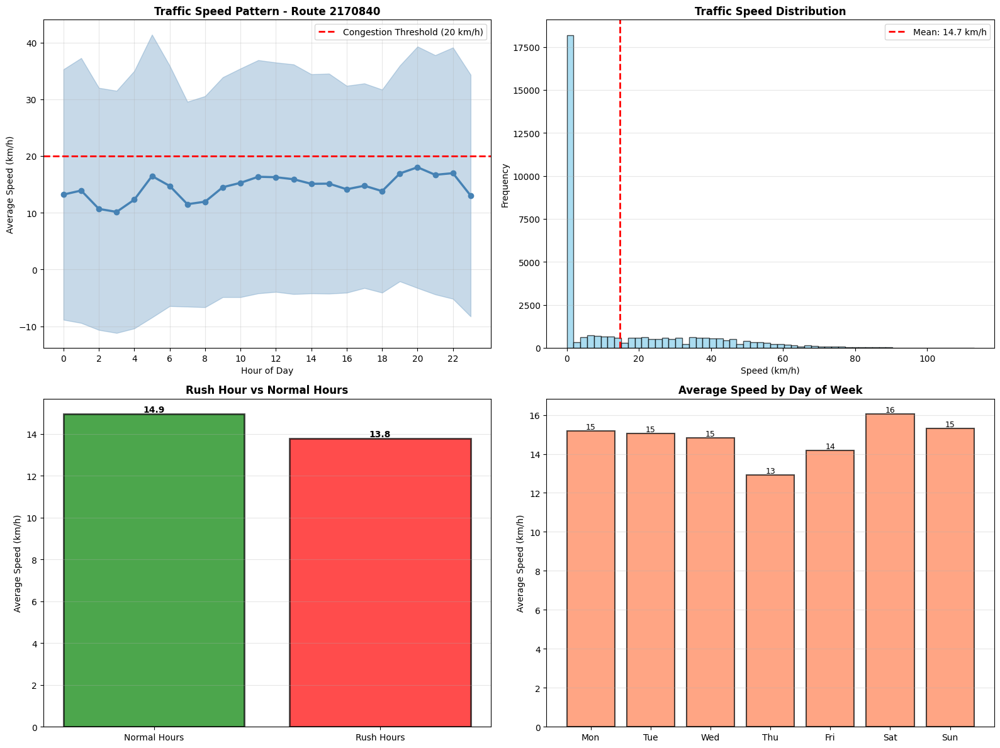

,segment_index,start_stop,end_stop,distance_km,predicted_speed_kmh,segment_travel_time_min,cumulative_travel_time_min,Time/km (min)
0,1,OPP Pata Pinklao,mahawitthayalai theknoloyi phra chom klao phra nakhon nuea,6.230,6.63,56.36,56.36,9.05
1,2,mahawitthayalai theknoloyi phra chom klao phra nakhon nuea,rongrian satri nonthaburi - wat paknam,1.017,6.63,9.20,65.56,9.05
2,3,rongrian satri nonthaburi - wat paknam,rongrian wat khamao phin ta ram,0.280,6.63,2.53,68.10,9.05
3,4,rongrian wat khamao phin ta ram,wat nakhon in,1.123,6.63,10.16,78.26,9.05
4,5,wat nakhon in,pongsawass,0.323,6.63,2.92,81.18,9.05
5,6,pongsawass,talat non,0.503,6.63,4.55,85.73,9.05
6,7,talat non,Lonely First Market,0.435,6.63,3.94,89.67,9.05
7,8,Lonely First Market,beep inn hotel,6.369,6.63,57.62,147.29,9.05
8,9,beep inn hotel,rongphayaban yan hi,11.154,6.63,100.91,248.20,9.05
9,10,rongphayaban yan hi,rongphayaban yan hi,0.005,6.63,0.05,248.24,9.05


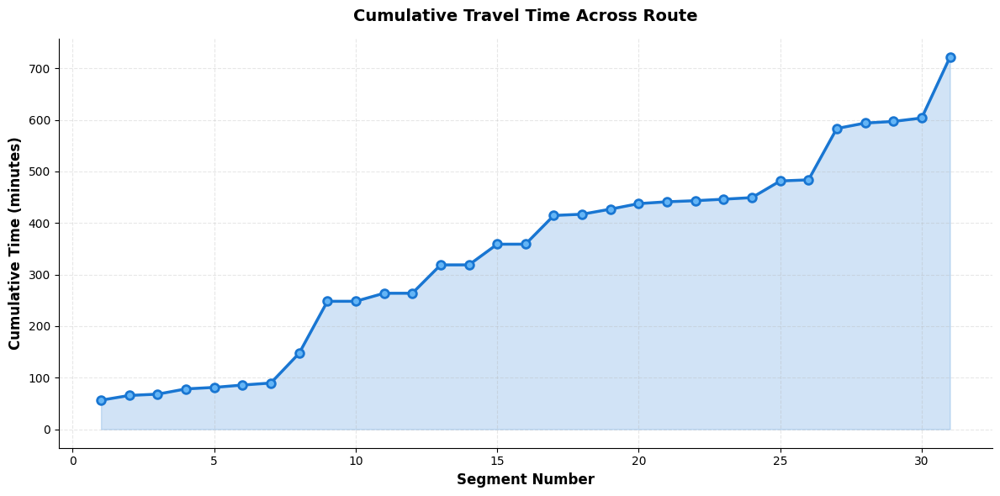

In [ ]:
# --- Initialize dropdown ---
from IPython.display import display, clear_output, HTML

# --- Dropdown setup ---
opts = [(make_label(r), r[ROUTE_ID]) for _, r in routes_ok.head(100).iterrows()]
dd = w.Dropdown(options=opts, description="Route:", layout=w.Layout(width="80%"))
out = w.Output()

# --- Dropdown callback ---
def on_change(ch):
    if ch["name"] == "value" and ch["new"] is not None:
        with out:
            clear_output(wait=True)
            route_id = str(ch["new"])

            # Model Performance
            display(HTML("<hr><h3 style='color:#2a5599'>🤖 Model Performance</h3>"))
            display_model_performance(route_id)

            # Map
            display(HTML("<hr><h3 style='color:#2a5599'>🗺️ Route Map</h3>"))
            map_obj = show_route_with_stops_raw(route_id)
            if map_obj:
                display(map_obj)

            # Charts
            display(HTML("<hr><h3 style='color:#2a5599'>📊 Traffic Analysis Charts</h3>"))
            display_route_chart(route_id)

            # Table
            display(HTML("<hr><h3 style='color:#2a5599'>📋 Segment-by-Segment Table</h3>"))
            display_segment_table(route_id)

dd.observe(on_change, names="value")
display(dd, out)
dd.value = opts[0][1]  # auto-load first route


In [ ]:
import folium
from folium import plugins
import ipywidgets as widgets
from IPython.display import display, HTML, clear_output
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

def create_bus_stop_interface(stops_df, routes_df, route_models):
    """
    Interactive interface using bus stop dropdowns with visualizations
    """

    # Prepare stops data
    stops_df = stops_df.dropna(subset=['lat', 'lon', 'refname'])
    stops_df['display_name'] = stops_df.apply(
        lambda row: f"{row['refname']} ({row['lat']:.4f}, {row['lon']:.4f})",
        axis=1
    )

    # Create stop options sorted alphabetically
    stop_options = sorted(
        [(row['display_name'], (row['lat'], row['lon']))
         for _, row in stops_df.iterrows()],
        key=lambda x: x[0]
    )

    # Widgets
    search_origin = widgets.Text(
        placeholder='Type to search origin stop...',
        description='Search Origin:',
        style={'description_width': '120px'},
        layout=widgets.Layout(width='500px')
    )

    origin_dropdown = widgets.Dropdown(
        options=[('-- Select Origin Stop --', None)] + stop_options,
        description='Origin Stop:',
        style={'description_width': '120px'},
        layout=widgets.Layout(width='500px')
    )

    search_dest = widgets.Text(
        placeholder='Type to search destination stop...',
        description='Search Dest:',
        style={'description_width': '120px'},
        layout=widgets.Layout(width='500px')
    )

    dest_dropdown = widgets.Dropdown(
        options=[('-- Select Destination Stop --', None)] + stop_options,
        description='Dest Stop:',
        style={'description_width': '120px'},
        layout=widgets.Layout(width='500px')
    )


    compare_btn = widgets.Button(
        description='🔍 Compare Routes',
        button_style='success',
        layout=widgets.Layout(width='200px', height='40px'),
        disabled=True
    )

    output = widgets.Output()

    # Search functionality
    def filter_stops(search_text, is_origin=True):
        if not search_text:
            return stop_options

        search_lower = search_text.lower()
        filtered = [
            opt for opt in stop_options
            if search_lower in opt[0].lower()
        ]
        return filtered

    def on_search_origin_change(change):
        filtered = filter_stops(change['new'], is_origin=True)
        origin_dropdown.options = [('-- Select Origin Stop --', None)] + filtered

    def on_search_dest_change(change):
        filtered = filter_stops(change['new'], is_origin=False)
        dest_dropdown.options = [('-- Select Destination Stop --', None)] + filtered

    def on_origin_change(change):
        check_ready()

    def on_dest_change(change):
        check_ready()

    def check_ready():
        if origin_dropdown.value and dest_dropdown.value:
            compare_btn.disabled = False
        else:
            compare_btn.disabled = True

    # Main comparison function
    def on_compare_click(b):
      with output:
          clear_output(wait=True)

          if not origin_dropdown.value or not dest_dropdown.value:
              print("Please select both origin and destination stops")
              return

          origin_lat, origin_lon = origin_dropdown.value
          dest_lat, dest_lon = dest_dropdown.value

          departure = datetime.combine(
              date_picker.value,
              datetime.min.time().replace(hour=hour.value, minute=minute.value)
          )

          # Display header
          display(HTML(f"""
          <div style="background: linear-gradient(135deg, #667eea 0%, #764ba2 100%);
                      color: white; padding: 20px; border-radius: 10px; margin-bottom: 20px;">
              <h2 style="margin: 0 0 15px 0;">Journey Options Analysis</h2>
              <div style="display: grid; grid-template-columns: 1fr 1fr; gap: 15px;">
                  <div>
                      <p style="margin: 5px 0;"><strong>Origin:</strong> {origin_dropdown.label.split('(')[0]}</p>
                  </div>
                  <div>
                      <p style="margin: 5px 0;"><strong>Destination:</strong> {dest_dropdown.label.split('(')[0]}</p>
                  </div>
              </div>
              <p style="margin: 15px 0 0 0;"><strong>Departure:</strong> {departure.strftime('%A, %B %d, %Y at %H:%M')}</p>
          </div>
          """))

          # NEW: Find routes with transfers
          print("Searching for journey options (direct and with transfers)...\n")
          results = find_routes_with_transfers(
              origin_lat, origin_lon,
              dest_lat, dest_lon,
              departure,
              routes_df,
              route_models,
              max_transfers=1
          )

          if results.empty:
              display(HTML("""
              <div style="background: #ffebee; color: #c62828; padding: 20px;
                          border-radius: 8px; border-left: 5px solid #c62828;">
                  <h3>No Routes Found</h3>
                  <p>Try increasing the search radius or selecting different stops.</p>
              </div>
              """))
              return

          # Display results summary
          print(f"Found {len(results)} journey options:")
          print(f"  - {len(results[results['type']=='Direct'])} direct routes")
          print(f"  - {len(results[results['type']=='Transfer'])} routes with 1 transfer\n")

          # Show top 5 options
          display(HTML("<h3>Top Journey Options</h3>"))

          for idx, row in results.head(5).iterrows():
              badge_color = '#2ecc71' if row['type'] == 'Direct' else '#3498db'

              route_info = f"<b>Route {row['route_1']}</b> ({row['route_1_name']})"
              if row['route_2']:
                  route_info += f" → <b>Route {row['route_2']}</b> ({row['route_2_name']})"

              display(HTML(f"""
              <div style="border: 2px solid {badge_color}; border-radius: 8px;
                          padding: 15px; margin: 10px 0; background: white;">
                  <div style="display: flex; justify-content: space-between; align-items: center;">
                      <div>
                          <span style="background: {badge_color}; color: black; padding: 4px 8px;
                                      border-radius: 4px; font-size: 12px; font-weight: bold;">
                              {row['type']}
                          </span>
                          <span style="font-size: 18px; color: {badge_color};font-weight: bold; margin-left: 10px;">
                              {route_info}
                          </span>
                      </div>
                      <div style="text-align: right;">
                          <div style="font-size: 24px; font-weight: bold; color: {badge_color};">
                              {row['total_time_min']:.0f} min
                          </div>
                          <div style="font-size: 12px; color: #666;">
                              Arrive: {row['arrival_time'].strftime('%H:%M')}
                          </div>
                      </div>
                  </div>
                  {f"<div style='margin-top: 10px; font-size: 13px; color: #666;'>Transfer at: {row['transfer_location']}</div>" if row['transfer_location'] else ""}
              </div>
              """))
    def create_comparison_charts(results, departure):
        """Create interactive Plotly visualizations"""

        # Create subplots
        fig = make_subplots(
            rows=2, cols=2,
            subplot_titles=(
                'Travel Time Comparison',
                'Speed vs Distance',
                'Time Difference from Fastest',
                'Route Metrics Radar'
            ),
            specs=[
                [{"type": "bar"}, {"type": "scatter"}],
                [{"type": "bar"}, {"type": "scatterpolar"}]
            ]
        )

        # Chart 1: Travel Time Bar Chart
        colors = ['#2ecc71' if i == 0 else '#e74c3c' if i == 1 else '#95a5a6'
                  for i in range(len(results))]

        fig.add_trace(
            go.Bar(
                x=results['route_name'],
                y=results['predicted_time_min'],
                marker_color=colors,
                text=results['predicted_time_min'].round(1),
                textposition='auto',
                name='Travel Time',
                hovertemplate='<b>%{x}</b><br>Time: %{y:.1f} min<extra></extra>'
            ),
            row=1, col=1
        )

        # Chart 2: Speed vs Distance Scatter
        fig.add_trace(
            go.Scatter(
                x=results['total_distance_km'],
                y=results['avg_speed_kmh'],
                mode='markers+text',
                marker=dict(
                    size=results['predicted_time_min'],
                    color=results['predicted_time_min'],
                    colorscale='RdYlGn_r',
                    showscale=True,
                    colorbar=dict(title="Time (min)")
                ),
                text=results['route_id'],
                textposition='top center',
                name='Routes',
                hovertemplate='<b>Route %{text}</b><br>' +
                             'Distance: %{x:.2f} km<br>' +
                             'Speed: %{y:.1f} km/h<extra></extra>'
            ),
            row=1, col=2
        )

        # Chart 3: Time Difference
        fig.add_trace(
            go.Bar(
                x=results['route_name'],
                y=results['time_diff_vs_fastest_min'],
                marker_color=['#2ecc71'] + ['#e74c3c'] * (len(results) - 1),
                text=results['time_diff_vs_fastest_min'].round(1),
                textposition='auto',
                name='Delay',
                hovertemplate='<b>%{x}</b><br>+%{y:.1f} min slower<extra></extra>'
            ),
            row=2, col=1
        )

        # Chart 4: Radar Chart for best route
        best_route = results.iloc[0]
        categories = ['Speed', 'Distance<br>(inverse)', 'Reliability', 'Time<br>(inverse)']

        # Normalize metrics to 0-100 scale
        max_speed = results['avg_speed_kmh'].max()
        max_dist = results['total_distance_km'].max()
        max_time = results['predicted_time_min'].max()
        max_reliable = results['slowest_segment_speed'].max()

        values = [
            (best_route['avg_speed_kmh'] / max_speed) * 100,
            (1 - best_route['total_distance_km'] / max_dist) * 100,
            (best_route['slowest_segment_speed'] / max_reliable) * 100,
            (1 - best_route['predicted_time_min'] / max_time) * 100
        ]

        fig.add_trace(
            go.Scatterpolar(
                r=values + [values[0]],
                theta=categories + [categories[0]],
                fill='toself',
                name='Best Route',
                line_color='#2ecc71'
            ),
            row=2, col=2
        )

        # Update layout
        fig.update_xaxes(title_text="Route", row=1, col=1)
        fig.update_yaxes(title_text="Minutes", row=1, col=1)

        fig.update_xaxes(title_text="Distance (km)", row=1, col=2)
        fig.update_yaxes(title_text="Speed (km/h)", row=1, col=2)

        fig.update_xaxes(title_text="Route", row=2, col=1)
        fig.update_yaxes(title_text="Additional Time (min)", row=2, col=1)

        fig.update_layout(
            height=800,
            showlegend=False,
            title_text=f"Route Analysis Dashboard - {departure.strftime('%H:%M')}",
            title_font_size=20
        )

        fig.show()

    def create_results_table(results):
        """Create styled results table"""

        display(HTML("<h3 style='margin-top: 30px;'>Detailed Route Comparison</h3>"))

        display_cols = [
            'rank', 'route_id', 'route_name', 'total_distance_km',
            'predicted_time_min', 'avg_speed_kmh',
            'time_diff_vs_fastest_min', 'arrival_time'
        ]

        styled = results[display_cols].style.format({
            'total_distance_km': '{:.2f}',
            'predicted_time_min': '{:.1f}',
            'avg_speed_kmh': '{:.1f}',
            'time_diff_vs_fastest_min': '+{:.1f}',
            'arrival_time': lambda x: x.strftime('%H:%M')
        }).background_gradient(
            subset=['predicted_time_min'],
            cmap='RdYlGn_r'
        ).set_properties(**{
            'text-align': 'center',
            'font-size': '13px'
        }).set_table_styles([
            {'selector': 'th', 'props': [
                ('background-color', '#667eea'),
                ('color', 'white'),
                ('font-weight', 'bold'),
                ('text-align', 'center'),
                ('padding', '12px')
            ]},
            {'selector': 'td', 'props': [
                ('padding', '10px')
            ]},
            {'selector': 'tr:hover', 'props': [
                ('background-color', '#f5f5f5')
            ]}
        ])

        display(styled)

    def create_comparison_map(origin_lat, origin_lon, dest_lat, dest_lon,
                             results, routes_df):
        """Create interactive map showing routes"""

        display(HTML("<h3 style='margin-top: 30px;'>Route Map</h3>"))

        # Create map centered between origin and destination
        center_lat = (origin_lat + dest_lat) / 2
        center_lon = (origin_lon + dest_lon) / 2

        m = folium.Map(
            location=[center_lat, center_lon],
            zoom_start=12,
            tiles='CartoDB positron'
        )

        # Add origin marker
        folium.Marker(
            [origin_lat, origin_lon],
            popup=f'<b>Origin</b><br>{origin_dropdown.label.split("(")[0]}',
            icon=folium.Icon(color='green', icon='play', prefix='fa'),
            tooltip='Origin'
        ).add_to(m)

        # Add destination marker
        folium.Marker(
            [dest_lat, dest_lon],
            popup=f'<b>Destination</b><br>{dest_dropdown.label.split("(")[0]}',
            icon=folium.Icon(color='red', icon='stop', prefix='fa'),
            tooltip='Destination'
        ).add_to(m)

        # Add routes
        colors = ['green', 'orange', 'red', 'purple', 'blue']
        for idx, (_, route) in enumerate(results.iterrows()):
            route_id = str(route['route_id'])
            route_data = routes_df[routes_df['route_id'].astype(str) == route_id].iloc[0]
            coords = parse_coordinates(route_data['coordinates'])

            if coords:
                # Convert [lon, lat] to [lat, lon] for folium
                coords_folium = [[lat, lon] for lon, lat in coords]

                color = colors[idx % len(colors)]
                folium.PolyLine(
                    coords_folium,
                    color=color,
                    weight=4 if idx == 0 else 2,
                    opacity=0.8 if idx == 0 else 0.5,
                    popup=f"<b>Rank #{route['rank']}</b><br>" +
                          f"Route: {route['route_name']}<br>" +
                          f"Time: {route['predicted_time_min']:.1f} min<br>" +
                          f"Speed: {route['avg_speed_kmh']:.1f} km/h",
                    tooltip=f"Route {route['route_id']}"
                ).add_to(m)

        # Add legend
        legend_html = f'''
        <div style="position: fixed; bottom: 50px; left: 50px; width: 200px;
                    background-color: white; border:2px solid grey; z-index:9999;
                    font-size:14px; padding:15px; border-radius: 5px;">
        <p style="margin:0 0 10px 0;"><b>Legend</b></p>
        <p style="margin:5px 0;">
            <i class="fa fa-play" style="color:green"></i> Origin
        </p>
        <p style="margin:5px 0;">
            <i class="fa fa-stop" style="color:red"></i> Destination
        </p>
        <hr style="margin: 10px 0;">
        <p style="margin:5px 0; font-size:12px;">
            <span style="color:green; font-weight:bold;">━━━</span> Fastest Route
        </p>
        <p style="margin:5px 0; font-size:12px;">
            <span style="color:orange; font-weight:bold;">━━━</span> Alternative Routes
        </p>
        </div>
        '''
        m.get_root().html.add_child(folium.Element(legend_html))

        display(m)

    def on_show_stops_click(b):
        with output:
            clear_output(wait=True)

            display(HTML("<h3>All Available Bus Stops</h3>"))

            # Create map with all stops
            m = folium.Map(
                location=[13.7563, 100.5018],
                zoom_start=11,
                tiles='CartoDB positron'
            )

            # Add marker cluster
            marker_cluster = plugins.MarkerCluster().add_to(m)

            for _, stop in stops_df.iterrows():
                folium.Marker(
                    [stop['lat'], stop['lon']],
                    popup=stop['refname'],
                    tooltip=stop['refname'],
                    icon=folium.Icon(color='blue', icon='bus', prefix='fa')
                ).add_to(marker_cluster)

            display(m)

            # Show stops table
            display(HTML("<h4>Stop List</h4>"))
            display(stops_df[['refname', 'lat', 'lon']].head(20))

    # Connect events
    search_origin.observe(on_search_origin_change, names='value')
    search_dest.observe(on_search_dest_change, names='value')
    origin_dropdown.observe(on_origin_change, names='value')
    dest_dropdown.observe(on_dest_change, names='value')
    compare_btn.on_click(on_compare_click)



    try:
        from zoneinfo import ZoneInfo
        now = datetime.now(ZoneInfo("Asia/Bangkok"))
    except:
        now = datetime.now()

    current_hour = now.hour
    current_minute = now.minute

    # Time widgets - Direct input without dropdown
    date_picker = widgets.DatePicker(
        description='Date:',
        value=now.date(),
        style={'description_width': '120px'}
    )

    hour = widgets.IntText(
        value=current_hour,
        min=0,
        max=23,
        description='Hour (0-23):',
        style={'description_width': '120px'},
        layout=widgets.Layout(width='200px')
    )

    minute = widgets.IntText(
        value=current_minute,
        min=0,
        max=59,
        description='Minute (0-59):',
        style={'description_width': '120px'},
        layout=widgets.Layout(width='200px')
    )

    # Add a display showing current selection
    time_display = widgets.HTML(
        value=f"<p style='color: #666; font-size: 13px;'>Current time: {now.strftime('%H:%M')}</p>"
    )


    # Layout
    interface = widgets.VBox([
    widgets.HTML("""
        <div style="background: linear-gradient(135deg, #667eea 0%, #764ba2 100%);
                    color: white; padding: 20px; border-radius: 10px; margin-bottom: 20px;">
            <h1 style="margin: 0;">Bangkok Bus Route Optimizer</h1>
            <p style="margin: 10px 0 0 0; opacity: 0.9;">
                Compare routes between bus stops and find the fastest path
            </p>
        </div>
        """),
        widgets.HTML("<h3>Select Stops</h3>"),
        search_origin,
        origin_dropdown,
        widgets.HTML("<br>"),
        search_dest,
        dest_dropdown,
        widgets.HTML("<h3>Departure Time</h3>"),
        time_display,
        widgets.HBox([hour, minute]),
        date_picker,
        widgets.HBox([compare_btn]),
        output
    ], layout=widgets.Layout(padding='20px'))

    return interface



interface = create_bus_stop_interface(stops_df, routes_df, route_models)
display(interface)

Searching for journey options (direct and with transfers)...

Searching for direct routes...
Searching for routes with one transfer...
Found 65 routes near origin
Found 31 journey options:
  - 21 direct routes
  - 10 routes with 1 transfer

